In [95]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from plotly.subplots import make_subplots
from IPython.display import display, HTML, clear_output
import sys
sys.path.append('../..')
from src.db.db_handler import DBHandler
from helpers.visualization import histograma
from helpers.preprocessing import format_fecha

In [3]:
db = DBHandler()

In [4]:
estaciones = db.get_columns("estaciones", ["idema", "provincia_id"])
provincias = db.get_columns("provincias", ["id", "nombre"])

In [5]:
provincias_df = pd.DataFrame(provincias)
estaciones_df = pd.DataFrame(estaciones)

In [6]:
temperatura = db.get_columns("temperatura_historico", ['fecha', 'idema', 'tmed'])
lluvia = db.get_columns("lluvia_historico", ['fecha', 'idema', 'prec'])
viento = db.get_columns("viento_historico", ['fecha', 'idema', 'velmedia'])
humedad = db.get_columns("humedad_historico", ['fecha', 'idema', 'hr_media'])

In [62]:
temperatura_df = pd.DataFrame(temperatura)
lluvia_df = pd.DataFrame(lluvia)
viento_df = pd.DataFrame(viento)
humedad_df = pd.DataFrame(humedad)

In [59]:
def merge_provincia(df):
    df = df.merge(estaciones_df, on="idema", how="left")
    df = df.merge(provincias_df, left_on="provincia_id", right_on="id", how="left")
    return df

In [63]:
temperatura_df = merge_provincia(temperatura_df)
lluvia_df = merge_provincia(lluvia_df)
viento_df = merge_provincia(viento_df)
humedad_df = merge_provincia(humedad_df)

In [67]:
def make_histogram(df: pd.DataFrame, col: str, x_label: str):
    
    df[col] = pd.to_numeric(df[col], errors="coerce")
    
    df['fecha'] = pd.to_datetime(df['fecha'])
    df = df.sort_values('fecha')

    fecha_ini = format_fecha(df['fecha'].min().strftime("%Y-%m-%d"))
    fecha_fin = format_fecha(df['fecha'].max().strftime("%Y-%m-%d"))
    
    title = f"Histograma de {x_label}\n de {fecha_ini} a {fecha_fin}"

    return histograma(df, title, col, x_label)

In [87]:
temperatura_hist = make_histogram(temperatura_df, "tmed", "Temperatura Media (°C)")
viento_hist = make_histogram(viento_df, "velmedia", "Velocidad Media del Viento")
lluvia_hist = make_histogram(lluvia_df, "prec", "Precipitación")
humedad_hist = make_histogram(humedad_df, "hr_media", "Humedad Media")

In [90]:
html = """
<div style="display: grid; grid-template-columns: 1fr 1fr; gap: 20px;">
    <div id="temp"></div>
    <div id="lluvia"></div>
    <div id="viento"></div>
    <div id="humedad"></div>
</div>
"""

t = temperatura_hist.to_html(div_id="temp", include_plotlyjs=False)
ll = lluvia_hist.to_html(div_id="lluvia", include_plotlyjs=False)
v = viento_hist.to_html(div_id="viento", include_plotlyjs=False)
h = humedad_hist.to_html(div_id="humedad", include_plotlyjs=False)

display(HTML(html + t + ll + v + h))

In [122]:
%matplotlib inline
def average_provincias(df: pd.DataFrame, col: str, label: str):
    df[col] = pd.to_numeric(df[col], errors="coerce")
    avg_provincia = df.groupby('nombre')[col].mean()
    
    avg_provincia = avg_provincia.sort_values()
    
    fig, ax = plt.subplots(figsize=(10, 6))
    avg_provincia.plot(kind='bar', ax=ax)
    
    ax.set_title(f"{label} media por provincia")
    ax.set_xlabel('Provincia')
    ax.set_ylabel(f'{label} Promedio')
    ax.set_xticks(ax.get_xticks())
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, ha='right')

    fig.show()

/tmp/ipykernel_53152/1244064328.py:17: UserWarning:

FigureCanvasAgg is non-interactive, and thus cannot be shown



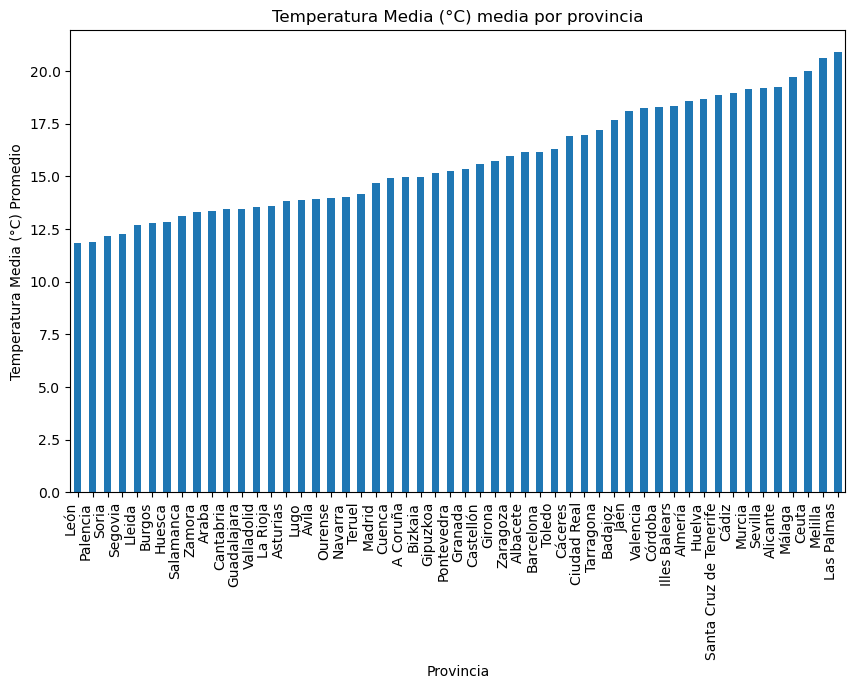

In [123]:
average_provincias(temperatura_df, 'tmed', 'Temperatura Media (°C)')

/tmp/ipykernel_53152/1244064328.py:17: UserWarning:

FigureCanvasAgg is non-interactive, and thus cannot be shown



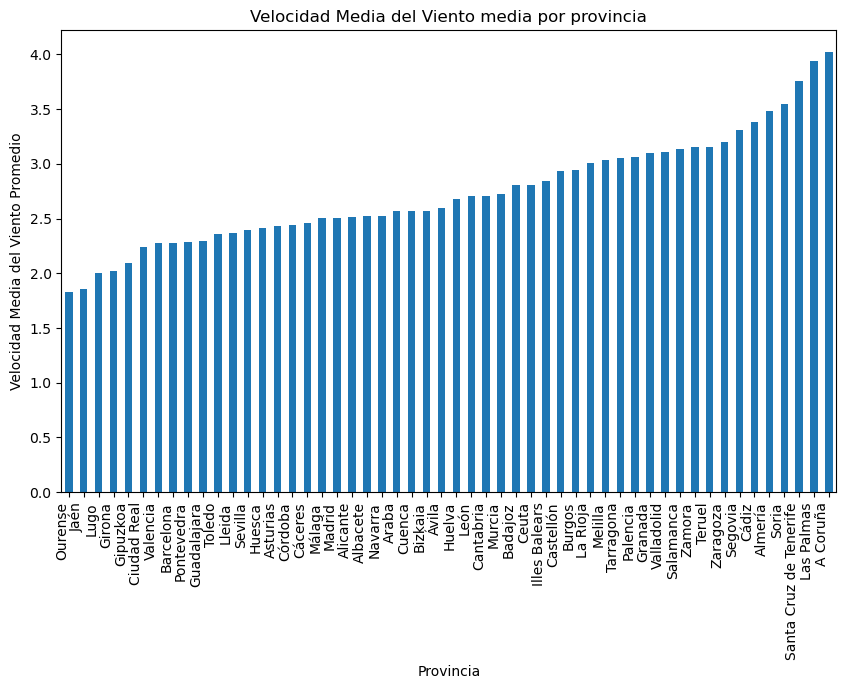

In [124]:
average_provincias(viento_df, 'velmedia', 'Velocidad Media del Viento')

/tmp/ipykernel_53152/1244064328.py:17: UserWarning:

FigureCanvasAgg is non-interactive, and thus cannot be shown



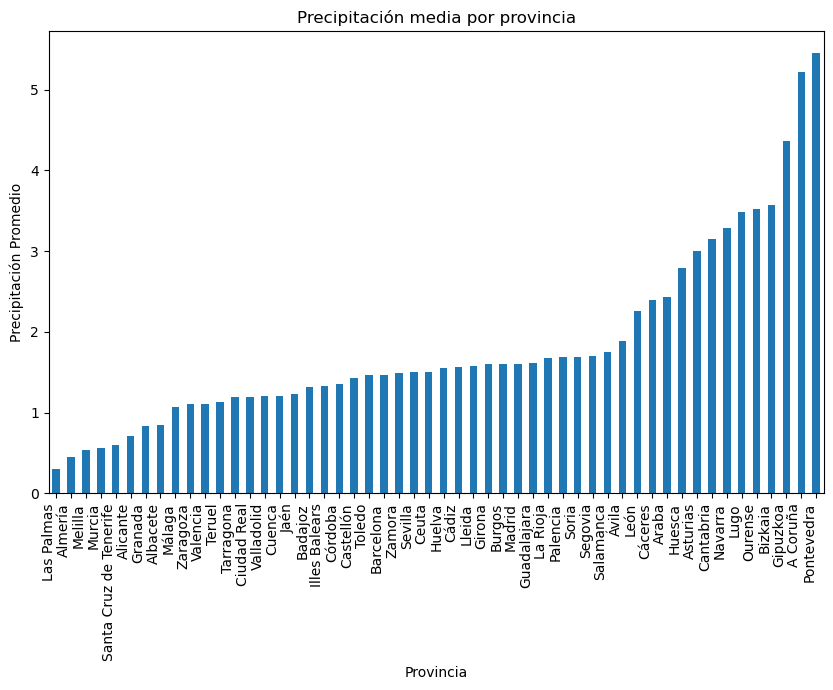

In [125]:
average_provincias(lluvia_df, 'prec', 'Precipitación')

/tmp/ipykernel_53152/1244064328.py:17: UserWarning:

FigureCanvasAgg is non-interactive, and thus cannot be shown



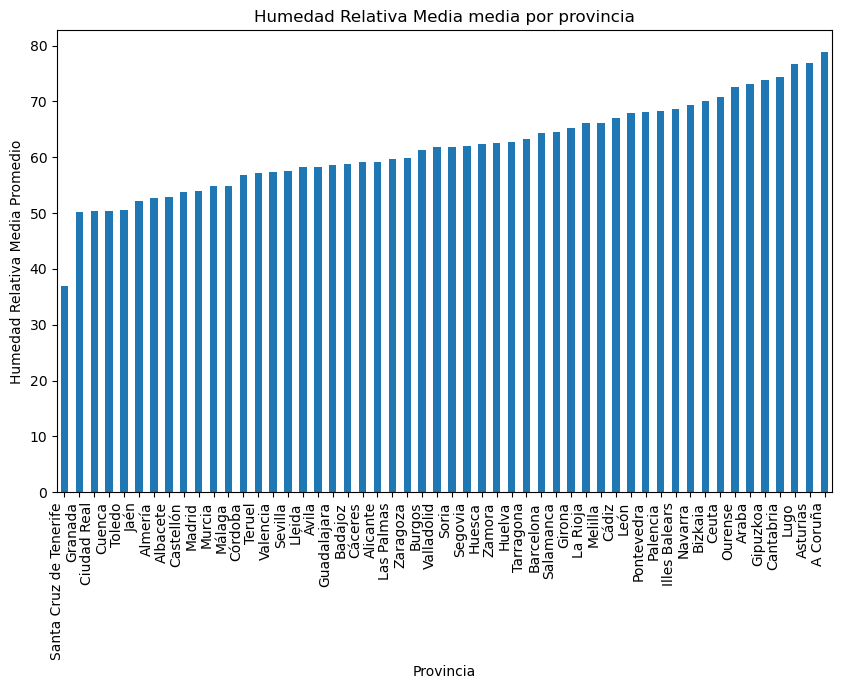

In [126]:
average_provincias(humedad_df, 'hr_media', 'Humedad Relativa Media')